In [1]:
!pip install pandas
!pip install plotly
!pip install seaborn
!pip install matplotlib

In [2]:
#PIGJ10119809 Jérome Pigeon

#Importation des librairies nécessaires
import pandas as pd
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
#Nomenclature en snake_case pour variables

data_raw = pd.read_csv("healthcare_dataset.csv")

print(data_raw.head())
print(data_raw.info())
print(data_raw.shape)

            Name  Age  Gender Blood Type Medical Condition Date of Admission  \
0  Bobby JacksOn   30    Male         B-            Cancer        2024-01-31   
1   LesLie TErRy   62    Male         A+           Obesity        2019-08-20   
2    DaNnY sMitH   76  Female         A-           Obesity        2022-09-22   
3   andrEw waTtS   28  Female         O+          Diabetes        2020-11-18   
4  adrIENNE bEll   43  Female        AB+            Cancer        2022-09-19   

             Doctor                    Hospital Insurance Provider  \
0     Matthew Smith             Sons and Miller         Blue Cross   
1   Samantha Davies                     Kim Inc           Medicare   
2  Tiffany Mitchell                    Cook PLC              Aetna   
3       Kevin Wells  Hernandez Rogers and Vang,           Medicare   
4    Kathleen Hanna                 White-White              Aetna   

   Billing Amount  Room Number Admission Type Discharge Date   Medication  \
0    18856.281306    

In [3]:
#Le dataset est assez bien construit, il ne semble pas y avoir de données manquantes.
#Toutefois, les noms des patients ne sont pas uniformes, alors nettoyont-les.
#Nettoyons aussi les dates pour mettre le bon type de données.
#Je vais aussi créer une variable unique contenant les valeurs nettoyées pour assurer l'intégrité des données.
#Après avoir fait toute l'analyse, découvert qu'il y avait des montants négatifs, ce qui est impossible. je les change en valeurs positives.

data = data_raw.copy()
data["Name"] = (data["Name"].str.title())
data["Date of Admission"] = pd.to_datetime(data["Date of Admission"], format='%Y-%m-%d')
data["Discharge Date"] = pd.to_datetime(data["Discharge Date"], format='%Y-%m-%d')
data['Billing Amount'] = data['Billing Amount'].abs()

#Après analyse, il semble que les noms d'hopitaux ne soient pas propres. On retrouve des nomes en double. Par exemple, je constate qu'il y a Ltd Smith et Smith Ltd. Nettoyons cette erreur pour n'avoir que Smith Ltd.
#Je vais éviter de nettoyer trop (exemple regrouper Inc Smith et LLT Smith), car je ne suis pas certain qu'il s'agit à 100% de la meme établissement.
data["Hospital"] = data["Hospital"].str.strip()
data["Hospital"] = data["Hospital"].str.lower()

#Trier les mots dans chaque nom et appliquer directement
data["Hospital"] = data["Hospital"].apply(lambda x: " ".join(sorted(x.split())))

#Pour remettre avec des majuscules sur le premier mot
data["Hospital"] = data["Hospital"].str.title()


print(data.info())



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55500 entries, 0 to 55499
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   Name                55500 non-null  object        
 1   Age                 55500 non-null  int64         
 2   Gender              55500 non-null  object        
 3   Blood Type          55500 non-null  object        
 4   Medical Condition   55500 non-null  object        
 5   Date of Admission   55500 non-null  datetime64[ns]
 6   Doctor              55500 non-null  object        
 7   Hospital            55500 non-null  object        
 8   Insurance Provider  55500 non-null  object        
 9   Billing Amount      55500 non-null  float64       
 10  Room Number         55500 non-null  int64         
 11  Admission Type      55500 non-null  object        
 12  Discharge Date      55500 non-null  datetime64[ns]
 13  Medication          55500 non-null  object    

In [4]:
#Nous avons maintenant des données plus propres. Noms uniformes et dates en format date reconnues.
#Toutefois, validons s'il n'y aurait pas de doublons de caché dans le dataset basé sur les colonnes et supprimons-les

duplicate_ligne = data[data.duplicated()]
print("Duplicate:\n", duplicate_ligne)



Duplicate:
                      Name  Age  Gender Blood Type Medical Condition  \
50023        Samuel Joyce   56    Male         O+         Arthritis   
50040    Kimberly Vasquez   26    Male         A-           Obesity   
50055      Scott Thornton   55  Female         B-           Obesity   
50070         William Lee   27  Female         O+         Arthritis   
50078  Christopher Norris   38    Male        AB-         Arthritis   
...                   ...  ...     ...        ...               ...   
55461      Connor Compton   63    Male         A+            Asthma   
55462       Alyssa Miller   35  Female         A-          Diabetes   
55464        Chris Hughes   35  Female        AB-           Obesity   
55484     Kenneth Alvarez   80    Male         O+            Cancer   
55491       Linda Griffin   47  Female         O+           Obesity   

      Date of Admission             Doctor                    Hospital  \
50023        2022-11-03     Krista Hartman              Thoma

In [5]:
#Il y a donc 534 dossiers qui sont des duplicates. Supprimons les doublons. Le total de données devrait etre de 54 966 après.


data = data.drop_duplicates()
print(data.info())

#54966 entries signifie que le ménage a bien été fait.

<class 'pandas.core.frame.DataFrame'>
Index: 54966 entries, 0 to 55499
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   Name                54966 non-null  object        
 1   Age                 54966 non-null  int64         
 2   Gender              54966 non-null  object        
 3   Blood Type          54966 non-null  object        
 4   Medical Condition   54966 non-null  object        
 5   Date of Admission   54966 non-null  datetime64[ns]
 6   Doctor              54966 non-null  object        
 7   Hospital            54966 non-null  object        
 8   Insurance Provider  54966 non-null  object        
 9   Billing Amount      54966 non-null  float64       
 10  Room Number         54966 non-null  int64         
 11  Admission Type      54966 non-null  object        
 12  Discharge Date      54966 non-null  datetime64[ns]
 13  Medication          54966 non-null  object        


Gender
Male      27496
Female    27470
Name: count, dtype: int64


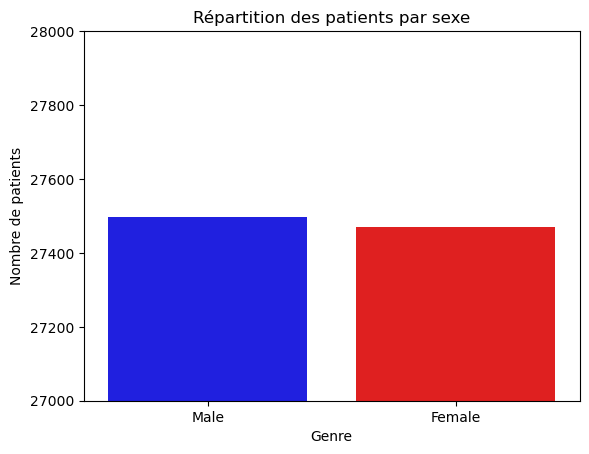

In [6]:
#Nous pouvons maintenant commencer notre analyse.

#Gender
#Créons un diagramme circulaire qui permet de voir la répartition Homme vs Femme.

#Garder valeurs de répartition homme femme dans une variable
stat_gender = data["Gender"].value_counts()
print(stat_gender)


#Graphique Plotly express
fig_gender = px.pie(names=stat_gender.index, values=stat_gender.values, title="Répartition des patients par genre", color={"Male": "Blue", "Female": "Red"})

# Formater les pourcentages pour afficher le texte un peu plus gros. Mettons aussi le titre centré
fig_gender.update_traces(textinfo='percent+label', textfont_size=15)
fig_gender.update_layout(title_x=0.5)
fig_gender.show()

#Le diagramme suivant montre la répartition des 54966 patients qui ont fréquentés les hopitaux.
#On constate que la répartition est presque pareil. Il y a 26 hommes de plus.
#Il serait intéressant de connaitre la proportion Homme/Femme dans la localisation ou ces données ont été prises pour comparer.






#créons un Countplot
sns.countplot(x="Gender", data=data, hue ="Gender", palette={"Male": "Blue", "Female": "Red"},legend=False)
plt.title("Répartition des patients par sexe")
plt.xlabel("Genre")
plt.ylabel("Nombre de patients")
plt.ylim(27000, 28000)
plt.show()



Gender
Male      27496
Female    27470
Name: count, dtype: int64


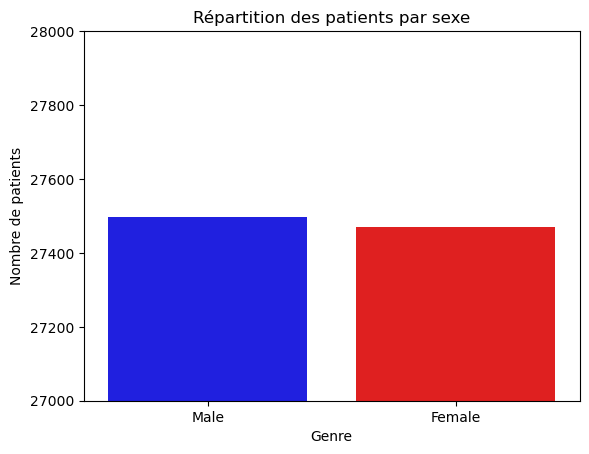

In [7]:
#Nous pouvons maintenant commencer notre analyse.

#Gender
#Créons un diagramme circulaire qui permet de voir la répartition Homme vs Femme.

#Garder valeurs de répartition homme femme dans une variable
stat_gender = data["Gender"].value_counts()
print(stat_gender)


#Graphique Plotly express
fig_gender = px.pie(names=stat_gender.index, values=stat_gender.values, title="Répartition des patients par genre", color={"Male": "Blue", "Female": "Red"})

# Formater les pourcentages pour afficher le texte un peu plus gros. Mettons aussi le titre centré
fig_gender.update_traces(textinfo='percent+label', textfont_size=15)
fig_gender.update_layout(title_x=0.5)
fig_gender.show()

#Le diagramme suivant montre la répartition des 54966 patients qui ont fréquentés les hopitaux.
#On constate que la répartition est presque pareil. Il y a 26 hommes de plus.
#Il serait intéressant de connaitre la proportion Homme/Femme dans la localisation ou ces données ont été prises pour comparer.






#créons un Countplot
sns.countplot(x="Gender", data=data, hue ="Gender", palette={"Male": "Blue", "Female": "Red"},legend=False)
plt.title("Répartition des patients par sexe")
plt.xlabel("Genre")
plt.ylabel("Nombre de patients")
plt.ylim(27000, 28000)
plt.show()

In [8]:
#Refaisons le graphique avec Plotly pour voir mieux les nombres de la répartition par Blood Type
fig_blood_type = px.histogram(data, x="Blood Type", title="Répartition des patients par groupe sanguin", color="Blood Type")

# Ajuster l'axe des Y pour zoomer sur 6750-6950, car les données sont très similaires (ce qui n'est pas réel).
fig_blood_type.update_yaxes(range=[6750, 6950])

# Changer les noms des axes pour une meilleur visualisation
fig_blood_type.update_layout(xaxis_title="Type sanguin", yaxis_title="Nombre de patients", title_x=0.5)
fig_blood_type.show()


#On constate évidemment que A- a 6898 personnes et A+ 6896, presque la meme chose.


In [9]:
#Répartition par Age

#Faisons un histograme pour représenter la quantité de patients selon l'age en utilisant Plotly
fig_age = px.histogram(data, x="Age", title="Répartition des patients par age", nbins=10)

# Changer les noms des axes pour une meilleur visualisation
fig_age.update_layout(xaxis_title="Age", yaxis_title="Nombre de patients", bargap=0.1, title_x=0.5)
fig_age.show()


#On constate qu'il y a très peu de patients entre 10 et 19 ans proportionnellement aux autres. Il en va relativement de meme pour 80 à 89 ans.
#On constate que la majorité des patients ont entre 50 et 59 ans avec 8263 personnes, mais qu'entre 20 et 79 ans les proportions sont très similaires.



#Calculont et affichons la moyenne d'age des patients
age_moyenne = data["Age"].mean().round(2)
print("L'age moyenne des patients est de : ",age_moyenne, " ans.")


L'age moyenne des patients est de :  51.54  ans.


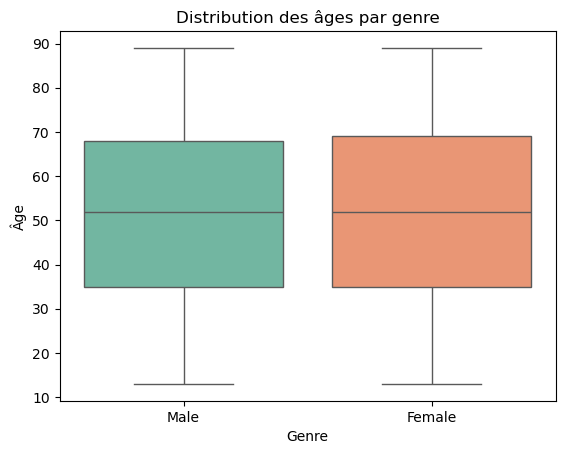

In [10]:
#Maintenant, il est intéressant de comparer la proportions d'hommes vs femmes selon leur age. Pour se faire, nous utiliseront un BoxPlot.


#Répartition des ages par genre
sns.boxplot(data, x='Gender', y='Age', hue ='Gender', palette='Set2', legend=False)

#Settings pour le graphique
plt.title("Distribution des âges par genre")
plt.xlabel("Genre")
plt.ylabel("Âge")
plt.show()


#Nous constatons qu'encore une fois les résultats sont étrangement similaires. La médiane est à 52 ans environ et la majorité des données entre 35 et 70 ans (Q1 et Q3).
#Cela semble suivre la tendence que nous avons vu dans le graphique de répartition des ages précédent.
#Toutefois, nous constatons que les Q3 des femmes est 1 ou 2 ans plus élevé que le Q3 des hommes.

In [11]:
#Maintenant, nous pouvons aussi comparer les résultats en utilisant un Heatmap pour comparer l'age et le sexe de chaque individu

# Créer une heatmap avec Plotly
fig_heatmap_age_sexe = px.density_heatmap(data.groupby(["Age", "Gender"]).size().reset_index(name="Count"), x="Age", y="Gender",z="Count", color_continuous_scale="Viridis", title="Répartition des patients par age et sexe")

#Settings pour le graphique
fig_heatmap_age_sexe.update_layout(xaxis_title="Age", yaxis_title="Sexe", legend_title="Nombre de patients", title_x=0.5)
fig_heatmap_age_sexe.show()












In [12]:
#Comme demandé, créont un graphique en 3D comparant l'age, le sexe et le groupe sanguin des patients.


fig_scatter_age_sexe_sang = px.scatter(data, x="Age", y="Blood Type", color="Gender", symbol="Blood Type", title="Répartition des patients par age, sexe et type sanguin")

#Settings pour le graphique
fig_scatter_age_sexe_sang.update_layout(xaxis_title="Age", yaxis_title="Goupe snaguin", legend_title="Sexe", title_x=0.5)
fig_scatter_age_sexe_sang.show()


In [13]:
#Maintenant que nous avons fait l'analyse de l'age, sexe et groupe sanguin, nous allons faire une analyse par fréquence des conditions médicales. 
#Construisont un graphique histogramme pour y arriver
fig_histogram_condition = px.histogram(data, x="Medical Condition", title="Répartition des patients selon leur condition médicale", color="Medical Condition")


# Changer les noms des axes pour une meilleur visualisation. Ajuster aussi les axes pour mieux voir
fig_histogram_condition.update_yaxes(range=[9000, 9300])
fig_histogram_condition.update_layout(xaxis_title="Condition médicale", yaxis_title="Nombre de patients", title_x=0.5)
fig_histogram_condition.show()



#On constate enfin une information intéressante. Le diabète et l'arthrite sont les deux conditions médicales les plus vues sur un patient.



In [14]:
#Je vais faire le meme graphique sous forme d'un graphique circulaire pour mieux comparer cette répartition

stat_circle_condition = data["Medical Condition"].value_counts()


#Graphique Plotly express
fig_circle_condition = px.pie(names=stat_circle_condition.index, values=stat_circle_condition.values, title="Répartition des patients selon la condition médicale", color={"Cancer": "Blue", "Obesity": "Red", "Diabetes": "Green", "Asthma": "Purple", "Hypertension": "orange", "Arthritis": "yellow"})

# Formater les pourcentages pour afficher le texte un peu plus gros
fig_circle_condition.update_traces(textinfo="percent+label", textfont_size=15)
fig_circle_condition.update_layout(title_x=0.5)
fig_circle_condition.show()




#On constate que meme si les proportions sont trop similaires (encore une fois), Diabète et Arthrite sont les plus élevés.


In [15]:
#Par curiosité, effectuons un graphique permettant de mettre en relation les conditions médicales et le genre, voir s'il y a un lien possible.

#Graphique 1 pour directement comparer
fig_condition_gender_1 = px.bar(data.groupby(["Gender", "Medical Condition"]).size().reset_index(name="Count"),x="Medical Condition", y="Count", color="Gender",barmode="group",title="Répartition des conditions médicales par genre",labels={"Medical Condition": "Condition Médicale", "Count": "Nombre de Patients"})
fig_condition_gender_1.update_yaxes(range=[4400, 4800])
fig_condition_gender_1.update_layout(title_x=0.5)
fig_condition_gender_1.show()

#Graphique 2 pour une représentation différente
fig_condition_gender_2 = px.bar(data.groupby(["Gender", "Medical Condition"]).size().reset_index(name="Count"),x="Medical Condition", y="Count", color="Gender",title="Répartition des conditions médicales par genre",labels={"Medical Condition": "Condition Médicale", "Count": "Nombre de Patients"})
fig_condition_gender_2.update_layout(title_x=0.5)
fig_condition_gender_2.show()



#On constate, encore une fois, que les répartitions sont trop similaires encore une fois.
#Toutefois, on constate qu'il y a un peu plus de femmes avec de l'arthrite et d'hommes avec de l'asthme.

In [16]:
#Par curiosité, effectuons un graphique permettant de mettre en relation les conditions médicales et l'age, voir s'il y a un lien possible.

fig_medical_age = px.box(data, x="Medical Condition", y="Age", title="Répartition des conditions selon l'age", labels={"Medical Condition": "Condition médicale", "Age": "Age"})
fig_medical_age.show()

#Encore une fois, les résultats sont beaucoup trop similaires les uns aux autres pour faire un constat.

In [17]:
#Maintenant, nous pouvons faire une analyse des types de résultats aux tests des patients


stat_circle_resultat = data["Test Results"].value_counts()


#Graphique Plotly express
fig_circle_resultat = px.pie(names=stat_circle_resultat.index, values=stat_circle_resultat.values, title="Répartition des patients selon le type de résultat obtenu")

# Formater les pourcentages pour afficher le texte un peu plus gros
fig_circle_resultat.update_traces(textinfo="percent+label", textfont_size=15)
fig_circle_resultat.update_layout(title_x=0.5)
fig_circle_resultat.show()

#On constate, comme d'habitude, une répartition quasi-parfaite des résultats. Abnormal étant un peu plus élevé que les autres, mais cela est négligeable.


In [18]:
#Par curiosité, effectuons un graphique permettant de mettre en relation les résultats et le genre, voir s'il y a un lien possible.
fig_results_gender = px.bar(data.groupby(["Gender", "Test Results"]).size().reset_index(name="Count"), x="Test Results", y="Count", color="Gender", barmode="group", title="Répartition des résultats au test selon le sexe", labels={"Test Results": "Résultats", "Count": "Nombre de patients"})
fig_results_gender.update_yaxes(range=[8500, 9500])
fig_results_gender.update_layout(title_x=0.5)
fig_results_gender.show()

#Malheureusement, aucun lien ne semble possible, encore une fois. Les données sont trop similaires.
#De facon négligeable, on pourrait dire que les hommes recoivent plys de résultats normaux que les femmes.


In [19]:
#Par curiosité, effectuons un graphique permettant de mettre en relation les résultats et l'age, voir s'il y a un lien possible.
fig_results_age = px.box(data, x="Test Results", y="Age", title="Répartition des résultats selon l'age", labels={"Test Results": "Résultats", "Age": "Age"})
fig_results_age.update_layout(title_x=0.5)
fig_results_age.show()





#Encore une fois, les résultats sont beaucoup trop similaires.

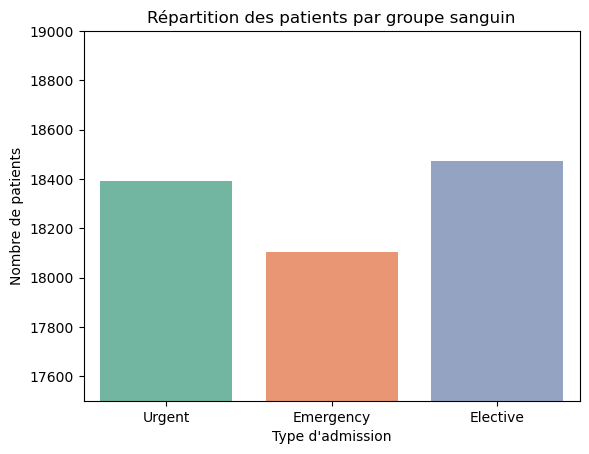

In [20]:
#Maintenant, nous pouvons faire une analyse hospitalière. Commencons par les types d’admission


#Faisons un histogramme avec Seaborn
# Correction de l'avertissement avec 'hue' = 'Blood Type' et 'legend=False', car utilisation de palette depreciated 
sns.countplot(data, x="Admission Type",hue ="Admission Type", palette="Set2", legend=False)

#Settings pour le graphique
# Ajuster l'axe des Y pour zoomer sur 6750-6950, car les données sont très similaires (ce qui n'est pas réel).
plt.ylim(17500, 19000)
plt.title("Répartition des patients par groupe sanguin")
plt.xlabel("Type d'admission")
plt.ylabel("Nombre de patients")
plt.show()


#Encore une fois, les données obtenues sont trop proportionnellement similaires.
#De facon négligeable, nous pourrions dire que "Elective" est le type le plus courant et Emergency le moins courant.


In [21]:
#Comme demandé, analysons maintenant la durée d'hospitalisation.

#Calcul de la durée d'hospitalisation en jours
data["Hospitalization Duration"] = (data["Discharge Date"] - data["Date of Admission"]).dt.days
duree_moyenne = data["Hospitalization Duration"].mean().round(2)
print("La durée moyenne d'hospitalisation de : ",duree_moyenne, " jours.")



La durée moyenne d'hospitalisation de :  15.5  jours.


In [22]:
#Maintenant, nous pouvons faire une petite comparaison entre le temps moyen d'attente d'hospitalisation et la condition médicale du patient

#Calcul de la durée moyenne par condition médicale
duree_condition_moyenne = data.groupby("Medical Condition")["Hospitalization Duration"].mean().reset_index()
print("La durée moyenne d'hospitalisation de (en jours) : \n", duree_condition_moyenne)

#Graphique
fig_duree_condition = px.bar(duree_condition_moyenne, x="Medical Condition", y="Hospitalization Duration", title="Durée Moyenne d'hospitalisation selon la condition médicale", labels={"Medical Condition": "Condition médicale", "Hospitalization Duration": "Durée moyenne (jours)"}, color="Medical Condition")
fig_duree_condition.update_yaxes(range=[10, 20])
fig_duree_condition.update_layout(title_x=0.5)
fig_duree_condition.show()



#On constate, encore une fois, que les données sont beaucoup trop similaires et proportionnelle entre les conditions médicales. la moyenne et toujours d'environ 15.5 jours.

La durée moyenne d'hospitalisation de (en jours) : 
   Medical Condition  Hospitalization Duration
0         Arthritis                 15.504231
1            Asthma                 15.677295
2            Cancer                 15.501204
3          Diabetes                 15.430664
4      Hypertension                 15.436236
5           Obesity                 15.447627


In [23]:
#Continuons avec une analyse de la médication la plus courante.

# Répartition des médications


#Affichons d'abord les résultats
print(data["Medication"].value_counts())


medication_count = data["Medication"].value_counts().reset_index()

fig_medication = px.bar(medication_count, x="Medication", y="count", title="Répartition des 5 médications remises aux patients", labels={"index": "Médication", "Medication": "Nombre de patients"}, color="Medication")
fig_medication.update_layout(title_x=0.5)
fig_medication.update_yaxes(range=[10500, 11500])
fig_medication.show()


#En regardans les nombres selon la médication, on constate que les résultats sont, encore une fois, trop proportionnelles
#Toutefois on pourrait dire que le Lipitor et l'Ibuprofen sont les deux médicaments un peu plus couramment prescrits, mais de facons très négligeable.

Medication
Lipitor        11038
Ibuprofen      11023
Aspirin        10984
Paracetamol    10965
Penicillin     10956
Name: count, dtype: int64


In [24]:
#Répartition par hopital, médecin et assurance

#Répartition des patients par hopital. On met dans une variable pour 
stat_hopital = data["Hospital"].value_counts()
print(stat_hopital)

#Faisons une analyse des 10 principaux hopitaux.
top_10_hopitaux = stat_hopital.head(10)
fig_hopital = px.pie(names=top_10_hopitaux.index, values=top_10_hopitaux.values, title="Top 10 des hôpitaux")
fig_hopital.update_layout(title_x=0.5)
fig_hopital.show()

#Ici, nous constatont que Smith LLC est l'hopital "Le plus populaire". En général, on constate que les hopitauix Smith sont les hopitaux les plus populaires.




#Répartition des patients par médecin
stat_medecin = data["Doctor"].value_counts()
print(stat_medecin)
#On constate que, suivant la tendance, les médecins Smith sont ceux qui ont traités le plus de patients.


top_10_medecin = stat_medecin.head(10)
fig_medecin = px.pie(names=top_10_medecin.index, values=top_10_medecin.values, title="Top 10 des médecins")
fig_medecin.update_layout(title_x=0.5)
fig_medecin.show()

#On constate que Michael Smith est le médecin qui a fait le plus de traitements.


#Répartition des patients par assurance
stat_assurance = data["Insurance Provider"].value_counts()
print(stat_assurance)


#On constate que Cigna est l'assurance le plus populaire assez significativement.


fig_assurance = px.pie(names=stat_assurance.index, values=stat_assurance.values, title="Répartition des companies d'assurance")
fig_assurance.update_layout(title_x=0.5)
fig_assurance.show()

Hospital
Ltd Smith                           76
Llc Smith                           76
Group Smith                         68
Plc Smith                           65
Inc Johnson                         60
                                    ..
And Green Kelly, Kline               1
And Griffin, Jennings Livingston     1
And Bradshaw Jones Jones,            1
And Levine Mosley Thomas,            1
Long-Cantrell                        1
Name: count, Length: 37009, dtype: int64


Doctor
Michael Smith       27
John Smith          22
Robert Smith        21
Michael Johnson     20
James Smith         20
                    ..
Shannon Morales      1
Arthur Fleming       1
Deborah Sutton       1
Mary Bartlett        1
Tiffany Mitchell     1
Name: count, Length: 40341, dtype: int64


Insurance Provider
Cigna               11139
Medicare            11039
UnitedHealthcare    11014
Blue Cross          10952
Aetna               10822
Name: count, dtype: int64


Le cout moyen d'un patient est de :  25546.244285500467 $


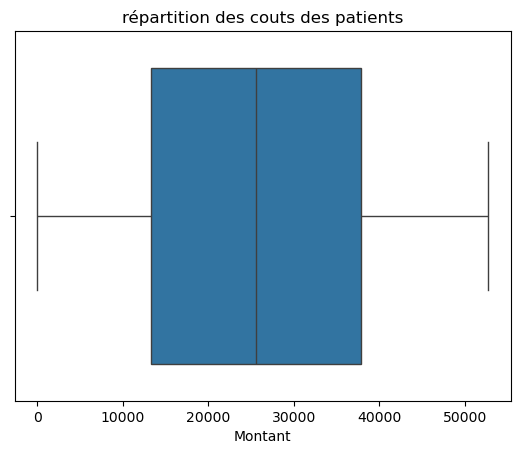

In [25]:
#Il s'agit de la dernière étape étape : L'analyse des couts.

#Commencons par faire ressortir certaines données intéressantes


#Moyenne
cout_moyenne = data["Billing Amount"].mean()
print("Le cout moyen d'un patient est de : ",cout_moyenne, "$")


#Consruisons un Scatterbox pour représenter la situation ici.
sns.boxplot(x=data["Billing Amount"])

#Settings pour le graphique
plt.title("répartition des couts des patients")
plt.xlabel("Montant")
plt.show()





In [26]:
#Analysons les couts moyens selon le type d'assurance des clients


#Calcul des montants moyen selon l'assurance
montant_assurance_moyenne = data.groupby("Insurance Provider")["Billing Amount"].mean().reset_index()
montant_assurance_somme = data.groupby("Insurance Provider")["Billing Amount"].sum().reset_index()
print("Les montants moyens de chaque fournisseurs d'assurance sont de : \n", montant_assurance_moyenne)
print("//////////////")
print("Voici le total des couts en $ de chaque selon le fournisseur :\n", montant_assurance_somme)

#Graphique
fig_assurance_montant = px.bar(montant_assurance_moyenne, x="Insurance Provider", y="Billing Amount", title="Montant moyen selon le fournisseur d'assurance", labels={"Insurance Provider": "Assurance", "Billing Amount": "Montant en $"}, color="Insurance Provider")
fig_assurance_montant.update_yaxes(range=[25000, 26000])
fig_assurance_montant.update_layout(title_x=0.5)
fig_assurance_montant.show()



#On constate que les résultats sont toujours équivalent selon le fournisseur encore une fois. Les moyennes tounent autour de 25 400$ et 25 600$.
#On constate que Medicare est beaucoup plus cher comparativement à UnitedHealthcare


Les montants moyens de chaque fournisseurs d'assurance sont de : 
   Insurance Provider  Billing Amount
0              Aetna    25553.016362
1         Blue Cross    25604.847319
2              Cigna    25528.218253
3           Medicare    25630.158260
4   UnitedHealthcare    25415.443284
//////////////
Voici le total des couts en $ de chaque selon le fournisseur :
   Insurance Provider  Billing Amount
0              Aetna    2.765347e+08
1         Blue Cross    2.804243e+08
2              Cigna    2.843588e+08
3           Medicare    2.829313e+08
4   UnitedHealthcare    2.799257e+08


In [27]:
#Comparaison du cout selon la condition

#Calcul de la somme des couts selon la condition médicale
montant_condition_somme = data.groupby("Medical Condition")["Billing Amount"].mean().reset_index()
print("Voici les moyennes des couts en $ de chaque selon la condition :\n", montant_condition_somme)
print("//////////////")
montant_condition_somme = data.groupby("Medical Condition")["Billing Amount"].sum().reset_index()
print("Voici le total des couts en $ de chaque selon la condition :\n", montant_condition_somme)


#Graphique
fig_condition_montant = px.box(data, x="Medical Condition", y="Billing Amount", title="Comparaison des couts selon la condition médicale", labels={"Medical Condition": "Condition Médicale", "Billing Amount": "Coût Facturé"})
fig_condition_montant.show()

Voici les moyennes des couts en $ de chaque selon la condition :
   Medical Condition  Billing Amount
0         Arthritis    25513.051895
1            Asthma    25635.639969
2            Cancer    25154.730597
3          Diabetes    25662.147109
4      Hypertension    25504.906200
5           Obesity    25806.628413
//////////////
Voici le total des couts en $ de chaque selon la condition :
   Medical Condition  Billing Amount
0         Arthritis    2.351793e+08
1            Asthma    2.331561e+08
2            Cancer    2.299142e+08
3          Diabetes    2.365023e+08
4      Hypertension    2.333954e+08
5           Obesity    2.360274e+08


In [28]:
#Faisont une petite comparaison selon le prix et le sexe.

cout_sexe_moyenne = data.groupby("Gender")["Billing Amount"].mean().reset_index()

#Graphique
fig_cout_sexe = px.bar(cout_sexe_moyenne, x="Gender", y="Billing Amount", title="Montant moyen selon le sexe", labels={"Gender": "Sexe", "Billing Amount": "Montant en $"}, color="Gender")
fig_cout_sexe.update_yaxes(range=[25000, 26000])
fig_cout_sexe.update_layout(title_x=0.5)
fig_cout_sexe.update_yaxes(range=[25000, 26000])
fig_cout_sexe.show()

In [29]:
#Faisont une petite comparaison selon le prix total, condition et le sexe.

montant_condition_sexe_somme = data.groupby(["Medical Condition", "Gender"])["Billing Amount"].sum().reset_index()

#Création heatmap
fig_montant_condition_sexe = px.density_heatmap(montant_condition_sexe_somme,x="Medical Condition", y="Gender", z="Billing Amount",color_continuous_scale='Viridis', title="Heatmap croisé des couts selon la condition médicale et le sexe",labels={"Medical Condition": "Condition médicale", "Gender": "Genre", "Billing Amount": "Cout"},facet_col="Gender", facet_col_wrap=2)
fig_montant_condition_sexe.show()

In [30]:
#Principales tendances observées : pathologies fréquentes, profils patients, coûts, durée de séjour.

print("Comme mentionné en commentaire du code, on constate que les données sont toujours réparties presque uniformément peu importe la variable.")
print("Considérant qu'il s'agit de données générées automatiquement, ce n'est pas surprenant.")
print()
print()

#Pathologies fréquentes
print("On constate que le Diabète et l'Arthrite sont les conditions médicales les plus fréquentes, mes de pas beaucoup plus par rapport aux autres.")
print("Toutefois, on constate qu'il y a un peu plus de femmes avec de l'arthrite et d'hommes avec de l'asthme.")
print()

#Profils des patients
print("On constate une répartition quasi 50%/50% d'hommes et de femmes. On constate que les patients sont agés d'entre 20 et 80 ans et que la moyenne d'age est de : ", age_moyenne, " ans")
print("On constate aussi que l'age en fonction du sexe n'a pas de réel impact sur la quantité. On pourrait dire qu'il y a une minime quantité de femme plus agées que d'homes, mais ceci est négligeable.")
print()
print("Voici un résumé des données selon l'age :")
print(data["Age"].describe())
print()

#Coûts facturés
print("On constate que la moyenne des couts par patient est de :", cout_moyenne, "$")
print()
print("Voici un résumé des données selon les montants :")
print(data["Billing Amount"].describe())
print()

#Durée de séjour
print("\nDurée moyenne d'hospitalisation par condition médicale :")
print("La durée moyenne d'un patient est de : ", duree_moyenne)

Comme mentionné en commentaire du code, on constate que les données sont toujours réparties presque uniformément peu importe la variable.
Considérant qu'il s'agit de données générées automatiquement, ce n'est pas surprenant.


On constate que le Diabète et l'Arthrite sont les conditions médicales les plus fréquentes, mes de pas beaucoup plus par rapport aux autres.
Toutefois, on constate qu'il y a un peu plus de femmes avec de l'arthrite et d'hommes avec de l'asthme.

On constate une répartition quasi 50%/50% d'hommes et de femmes. On constate que les patients sont agés d'entre 20 et 80 ans et que la moyenne d'age est de :  51.54  ans
On constate aussi que l'age en fonction du sexe n'a pas de réel impact sur la quantité. On pourrait dire qu'il y a une minime quantité de femme plus agées que d'homes, mais ceci est négligeable.

Voici un résumé des données selon l'age :
count    54966.000000
mean        51.535185
std         19.605661
min         13.000000
25%         35.000000
50%      

In [31]:
#Tests abnormaux

#Filtrer les données pour ne garder que les cas abnormaux
abnormal_data = data[data["Test Results"] == "Abnormal"]


fig_abnormal_condition = px.histogram(abnormal_data, x="Medical Condition", color="Medical Condition", title="Répartition des cas abnormaux par condition médicale", labels={"Medical Condition": "Condition Médicale", "count": "Nombre de cas abnormaux"})

fig_abnormal_condition.update_layout(title_x=0.5, xaxis_title="Condition médicale", yaxis_title="Nombre de cas abnormaux")

fig_abnormal_condition.show()


print("On constate que les cas abnormaux sont assez répartits unirformément selon les conditions médicales. Toutefois, l'obésité, l'arthrite et le diabète semble etre un peu plus élevés.")

On constate que les cas abnormaux sont assez répartits unirformément selon les conditions médicales. Toutefois, l'obésité, l'arthrite et le diabète semble etre un peu plus élevés.


In [32]:
#Relation entre les cas abnormaux et la medication recu

fig_abnormal_medication = px.histogram(abnormal_data, x="Medication", color="Medication", title="Répartition des cas abnormaux par médication", labels={"Medication": "Médication", "count": "Nombre de cas abnormaux"})
fig_abnormal_medication.update_layout(title_x=0.5, xaxis_title="Médication", yaxis_title="Nombre de cas abnormaux")
fig_abnormal_medication.show()


print("On constate qu'il n'y a aucun lien entre les deux.")

On constate qu'il n'y a aucun lien entre les deux.


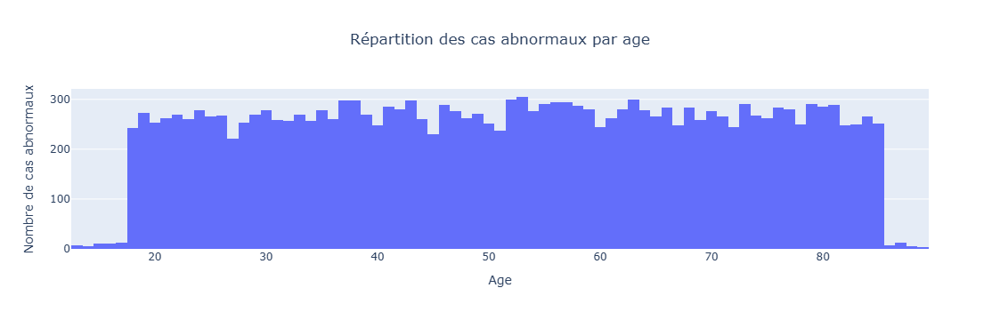

L'âge moyen des cas abnormaux est :  51.64066822151109  ans. Ceci est similaire à l'age moyenne des patients.


In [33]:
#Relation entre les cas abnormaux et l'age

fig_abnormal_age = px.histogram(abnormal_data, x="Age", title="Répartition des cas abnormaux par age", labels={"Age": "Age", "count": "Nombre de cas abnormaux"})
fig_abnormal_age.update_layout(title_x=0.5, xaxis_title="Age", yaxis_title="Nombre de cas abnormaux")
fig_abnormal_age.show()

age_abnormal_moyenne = abnormal_data["Age"].mean()

#Afficher le résultat
print("L'âge moyen des cas abnormaux est : ", age_abnormal_moyenne, " ans. Ceci est similaire à l'age moyenne des patients.")
